In [1]:
import osmnx as ox
import matplotlib.pyplot as plt
import geopandas as gp
import networkx as nx
import os.path
from os import path
import pathlib
import pandas as pd
from shapely.geometry import LineString
from matplotlib.colors import ListedColormap    
%matplotlib inline

plt.rcParams['figure.figsize'] = (140, 125)
ox.config(log_console=True, use_cache=True)

In [2]:
bike = gp.read_file('../results/berlin-bicycleedges.geojson')

In [4]:
bike.length.min()

<ipython-input-4-dac1269a1b84>:1: UserWarning: Geometry is in a geographic CRS. Results from 'length' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  bike.length.min()


1.2041594592645714e-06

In [5]:
mycolor = ListedColormap('green')        
fig = bike.plot(color=bike.color)


In [7]:
bike

,length,color,geometry
0,38.237,#c7c7c7,"LINESTRING (13.33550 52.56521, 13.33560 52.565..."
1,470.585,#c7c7c7,"LINESTRING (13.33550 52.56521, 13.33565 52.565..."
2,310.882,#c7c7c7,"LINESTRING (13.33550 52.56521, 13.33533 52.565..."
3,17.179,#c7c7c7,"LINESTRING (13.34661 52.56703, 13.34664 52.56688)"
4,171.849,#c7c7c7,"LINESTRING (13.34661 52.56703, 13.34659 52.567..."
...,...,...,...
267971,275.895,#c7c7c7,"LINESTRING (13.50087 52.43517, 13.50125 52.435..."
267972,369.096,#c7c7c7,"LINESTRING (13.50087 52.43517, 13.50057 52.435..."
267973,44.756,#c7c7c7,"LINESTRING (13.51309 52.42869, 13.51316 52.42909)"
267974,44.756,#c7c7c7,"LINESTRING (13.51316 52.42909, 13.51309 52.42869)"


In [8]:
bike_copy = bike.copy()

In [9]:
bike_copy

,length,color,geometry
0,38.237,#c7c7c7,"LINESTRING (13.33550 52.56521, 13.33560 52.565..."
1,470.585,#c7c7c7,"LINESTRING (13.33550 52.56521, 13.33565 52.565..."
2,310.882,#c7c7c7,"LINESTRING (13.33550 52.56521, 13.33533 52.565..."
3,17.179,#c7c7c7,"LINESTRING (13.34661 52.56703, 13.34664 52.56688)"
4,171.849,#c7c7c7,"LINESTRING (13.34661 52.56703, 13.34659 52.567..."
...,...,...,...
267971,275.895,#c7c7c7,"LINESTRING (13.50087 52.43517, 13.50125 52.435..."
267972,369.096,#c7c7c7,"LINESTRING (13.50087 52.43517, 13.50057 52.435..."
267973,44.756,#c7c7c7,"LINESTRING (13.51309 52.42869, 13.51316 52.42909)"
267974,44.756,#c7c7c7,"LINESTRING (13.51316 52.42909, 13.51309 52.42869)"


In [10]:
bike_copy = bike_copy[bike_copy.color != '#c7c7c7']

In [11]:
bike_copy

,length,color,geometry
15,119.805,#0800ff,"LINESTRING (13.33737 52.55878, 13.33725 52.558..."
16,10.295,#0800ff,"LINESTRING (13.33607 52.55952, 13.33597 52.55945)"
18,112.639,#0800ff,"LINESTRING (13.33607 52.55952, 13.33578 52.559..."
19,13.660,#0800ff,"LINESTRING (13.33064 52.56262, 13.33047 52.56255)"
20,42.844,#0800ff,"LINESTRING (13.33064 52.56262, 13.33075 52.562..."
...,...,...,...
267627,22.319,#0800ff,"LINESTRING (13.42429 52.46359, 13.42444 52.463..."
267628,31.589,#0800ff,"LINESTRING (13.42429 52.46359, 13.42421 52.463..."
267683,16.447,#0800ff,"LINESTRING (13.44526 52.46208, 13.44536 52.46195)"
267969,6.324,#91ff00,"LINESTRING (13.50087 52.43517, 13.50081 52.43521)"


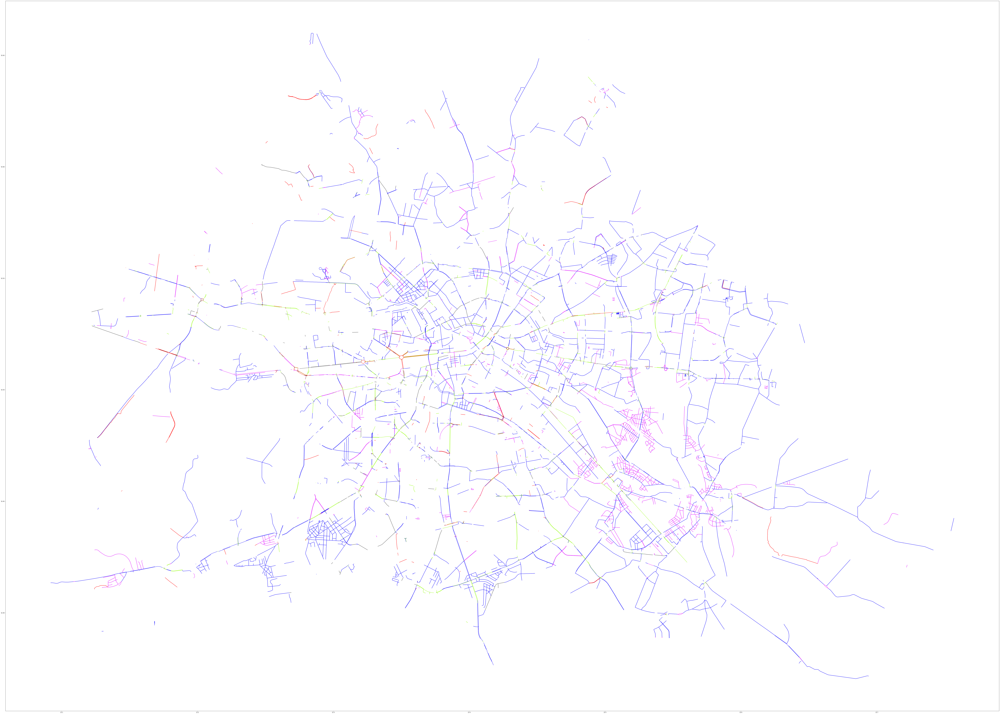

In [14]:
fig = bike_copy.plot(color=bike_copy.color)

In [15]:
bike_copy.to_file("../results/berlin-bycycleedges-important-ways.geojson",driver='GeoJSON')

In [4]:
place_name = "Berlin, Germany"

In [5]:
bicyclegraph = ox.graph_from_place(place_name, simplify=False, retain_all=True, network_type='bike')#, custom_filter=['power'~'line'])

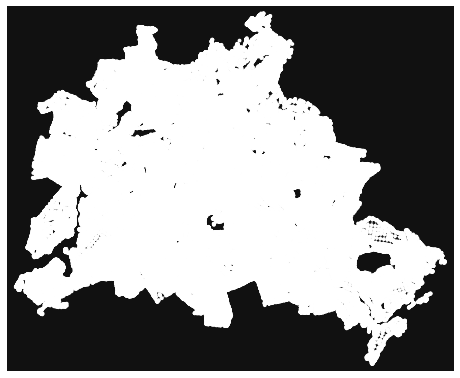

<Figure size 10080x9000 with 0 Axes>

In [6]:
fig, ax = ox.plot_graph(bicyclegraph)
plt.tight_layout()